In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from segment_anything import SamPredictor, sam_model_registry
from PIL import Image
import os
import csv
import base64
import requests
import json
from utils import *

In [2]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))    

In [3]:
def get_area(gray_image, mask, threshold):
    '''
    Go through the image and get the area of all the pixels above the threshold
    '''
    total = 0
    count = 0
    new_mask = np.zeros(mask.shape)
    for y in range(mask.shape[0]):
        for x in range(mask.shape[1]):
            if mask[y, x]:
                pixel_value = gray_image[y,x][0]
                if pixel_value >= threshold: 
                    total += 1
                    new_mask[y,x] = 1
                count += 1

    print(total/count)
    return new_mask

def get_gradient(gray_image, masks, scores):
    '''
    Go layer by layer during the image
    Plot the 
    '''
    main_mask, _ = get_main_mask(masks, scores)

    gradient = []
    for y in range(main_mask.shape[0]):
        total = 0
        count = 0
        for x in range(main_mask.shape[1]):
            if main_mask[y, x]:
                total += gray_image[y,x][0]
                count += 1
        if count != 0:
            gradient.append(total // count)
        else:
            gradient.append(0)

    return gradient

def get_main_mask(masks, scores):
    sorted_masks = sorted(zip(masks, scores), key=lambda x: x[1], reverse=True)
    for mask in sorted_masks: print(mask[1])
    main_mask = sorted_masks[0][0]
    main_mask_score = sorted_masks[0][1]
    return main_mask, main_mask_score

In [4]:
sam = sam_model_registry["default"](checkpoint="../../../Downloads/sam_vit_h_4b8939.pth")
predictor = SamPredictor(sam)

In [5]:
def get_bounding_box(main_mask, new_image):

    boundingBox = {
        "topLeft": None,
        "bottomRight": [0,0],
    }

    topLeft = False

    for i in range(len(new_image)):
        for j in range(len(new_image[0])):
            if not main_mask[i][j]:
                new_image[i][j] = [0, 0, 0]
            else:
                print(i, j)
                if not topLeft:
                    boundingBox["topLeft"] = [j, i]
                    topLeft = True
                boundingBox["bottomRight"] = [max(boundingBox["bottomRight"][0], j), max(boundingBox["bottomRight"][1], i)]
    
    return new_image, boundingBox

In [6]:
def get_middle_coordinate(top_left_x, top_left_y, wBox, hbox):
    '''
    Get the center of the box
    '''
    return top_left_x + wBox // 2, top_left_y + hbox // 2


In [7]:
def convertPoint(point, boundingBox, width, height, x_axis, y_axis):
    top_left_x, top_left_y = point
    x = (top_left_x - boundingBox["topLeft"][0]) * (x_axis[1] - x_axis[0]) / width
    y = y_axis[1] - (top_left_y - boundingBox["topLeft"][1]) * (y_axis[1] - y_axis[0]) / height
    return [x, y]


In [8]:
def get_filtered_answer(mask, x0, y0, wBox, hBox, max_x, max_y):
    for x in range(x0, x0 + wBox + 1):
        for y in range(y0, y0 + hBox + 1):
            if x <= max_x and y <= max_y and mask[y, x] == 1: 
                return True
    return False

In [39]:
import math
# Original color definitions with improved range calculations
colors = [
    ("black", [(0, 0, 0), (0, 0, 0)]),
    ("white", [(255, 255, 255), (255, 255, 255)]),
    ("red", [(255, 0, 0), (128, 128, 128)]),
    ("green", [(0, 255, 0), (64, 205, 64)]),
    ("blue", [(0, 0, 255), (64, 64, 205)]),
    ("yellow", [(255, 255, 0), (191, 191, 64)]),
    ("magenta", [(255, 0, 255), (128, 128, 205)]),
    ("cyan", [(0, 255, 255), (64, 205, 205)]),
    ("grey", [(64, 64, 64), (192, 192, 192)]),
]

def get_nearest_color(pixel):
    for color, range in colors:
        r1, g1, b1 = range[0]
        r2, g2, b2 = range[1]

        if r1 <= pixel[0] <= r2 or r2 <= pixel[0] <= r1:
            if g1 <= pixel[1] <= g2 or g2 <= pixel[1] <= g1:
                if b1 <= pixel[2] <= b2 or b2 <= pixel[2] <= b1:
                    return color
    return ""

In [22]:
def get_points(boundingBox, image_name, color, wBox, hBox, x_axis, y_axis, threshold=25):

    graph = []
    image = Image.open(image_name)
    image = image.convert('RGB')
    pixels = np.array(image)
    mask = np.zeros((pixels.shape[0], pixels.shape[1]))

    for y in range(pixels.shape[0]):  # iterate over height
        for x in range(pixels.shape[1]):  # iterate over width
            
            # Get the current pixel
            pixel = pixels[y, x]
            new_color = get_nearest_color(pixel)
            if new_color != "white": print(new_color)
            if new_color == color:
                mask[y, x] = 1

    for x0 in range(boundingBox["topLeft"][0], boundingBox["bottomRight"][0], wBox):
        for y0 in range(boundingBox["topLeft"][1], boundingBox["bottomRight"][1], hBox):
            
            x, y = get_middle_coordinate(x0, y0, wBox, hBox)
            value = get_filtered_answer(mask, x0, y0, wBox, hBox, boundingBox["bottomRight"][0], boundingBox["bottomRight"][1])

            width = boundingBox["bottomRight"][0] - boundingBox["topLeft"][0]
            height = boundingBox["bottomRight"][1] - boundingBox["topLeft"][1]

            if value: 
                graph.append({
                "topLeft": (x0, y0), 
                "middle": convertPoint((x,y), boundingBox, width, height, x_axis, y_axis), 
                })
    
    return graph

In [10]:
def getColoredGrid(boundingBox, image_name, color, save_name, wBox, hBox):
    new_image = Image.open(image_name)

    plt.figure(figsize=(5,5))
    plt.axis('off')
    plt.imshow(new_image)

    count = 0
    
    for x0 in range(boundingBox["topLeft"][0], boundingBox["bottomRight"][0], wBox):
        for y0 in range(boundingBox["topLeft"][1], boundingBox["bottomRight"][1], hBox):

            if count < len(color) and color[count]["topLeft"][0] == x0 and color[count]["topLeft"][1] == y0:
                print("here")
                plt.gca().add_patch(plt.Rectangle((x0, y0), wBox, hBox, edgecolor='orange', facecolor=(1, 0.5, 0, 0.5), lw=2))
                count+=1
            
            else:
                plt.gca().add_patch(plt.Rectangle((x0, y0), wBox, hBox, edgecolor='orange', facecolor=(0,0,0,0), lw=2))

    plt.savefig(save_name)

In [11]:
def create_directory(directory):
    exists = os.path.exists(directory)
    if not exists:
        os.makedirs(directory)

In [12]:
def x_y(coordinates, title, x_axis_title, y_axis_title, filename, c, x_range, y_range, axis_labels, csv_filename, normalize = False):

    data_for_csv = []
    plt.figure(figsize=(10,6))

    for index, value in enumerate(coordinates):
        x = []
        y = []

        for i in range(len(value)):
            x.append(value[i]["middle"][0])
            y.append(value[i]["middle"][1])
        
        print(c[index])
        color_normalized = c[index]

        if normalize and len(x) > 0:
            Q1_x, Q3_x = np.percentile(x, [25, 75])
            IQR_x = Q3_x - Q1_x
            Q1_y, Q3_y = np.percentile(y, [25, 75])
            IQR_y = Q3_y - Q1_y

            outliers_x = []
            outliers_y = []
            real_x = []
            real_y = []
            for i, x_i in enumerate(x):
                if x_i < Q1_x - 1.5 * IQR_x or x_i > Q3_x + 1.5 * IQR_x or y[i] < Q1_y - 1.5 * IQR_y or y[i] > Q3_y + 1.5 * IQR_y:
                    outliers_x.append(x_i)
                    outliers_y.append(y[i])
                else:
                    real_x.append(x_i)
                    real_y.append(y[i])
        
            plt.plot(real_x, real_y, label=axis_labels[index], color=color_normalized)
            plt.scatter(outliers_x, outliers_y, label=axis_labels[index] + ' Outliers', color=color_normalized, marker='*')
            
        else:
            plt.plot(x, y, label=axis_labels[index], color=color_normalized)

        for i, x_i in enumerate(x):
            data_for_csv.append([x_i, y[i], axis_labels[index]])

    

    plt.xlim(x_range[0], x_range[1])
    plt.ylim(y_range[0], y_range[1])

    # Add title and labels
    plt.title(title)
    plt.xlabel(x_axis_title)
    plt.ylabel(y_axis_title)
    plt.legend()

    # Show the plot
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(filename)

    # Write to CSV
    with open(csv_filename, 'w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow([x_axis_title, y_axis_title, "Type"])  # Header
        writer.writerows(data_for_csv)

In [13]:
def do_analysis(image_number):
    image_name = '../plot_images/'+str(image_number)+'.png'
    image = cv2.imread(image_name)

    height, width = image.shape[:2]
    input_point = np.array([[width // 2 - 50, height // 2 - 50], [width // 2 - 50, height // 2 + 50], [width // 2 + 50, height // 2 - 50], [width // 2 + 50, height // 2 + 50]])
    input_label = np.array([1, 1, 1, 1])

    predictor.set_image(image)

    masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True,
        )
    main_mask, main_mask_score = get_main_mask(masks, scores)
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(main_mask, plt.gca())

    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask Score: {main_mask_score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()

    n_image = image.copy()
    new_image, boundingBox = get_bounding_box(main_mask, n_image)

    points = np.array([
        boundingBox["topLeft"], 
        [boundingBox["topLeft"][0], boundingBox["bottomRight"][1]], 
        [boundingBox["bottomRight"][0], boundingBox["topLeft"][1]], 
        boundingBox["bottomRight"]
    ])

    plt.figure(figsize=(10,10))
    plt.imshow(new_image)
    show_points(points, np.array([1,1,1,1]), plt.gca())
    plt.show()
    
    return image_name, boundingBox

In [17]:
# Function to encode the image to base64
def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        encoded_string = base64.b64encode(image_file.read()).decode()
    return encoded_string

def get_metadata_gpt(image_name):

    '''
    PROMPT TO GPT
    ------------------

    Based on the plot:

    1. What is the title of the x-axis?
    2. What is the range of the x-axis?
    3. What is the title of the y-axis?
    4. What is the range of the y-axis?
    5. What are the different types?

    Can you provide the answers to the aforementioned questions in the following format:

    answers = {
    "x-axis": {
    "title": [INSERT TITLE HERE IN STRING FORMAT],
    "range":  [INSERT RANGE HERE IN NUMERICAL FORMAT],
    },
    "y-axis": {
    "title": [INSERT TITLE HERE IN STRING FORMAT],
    "range":  [INSERT RANGE HERE IN NUMERICAL FORMAT],
    },
    "types": [INSERT THE TYPES IN LIST OF TUPLES OF LENGTH = 2 WHERE EACH TUPLE LOOKS LIKE (TYPE NAME, MARKER COLOR in "black", "white", "red","green","blue", "yellow", "magenta", "cyan", "grey")]
    }

    '''
            
    if len(answers) != 0:
        return answers

    # Encode the image
    encoded_image = encode_image(image_name)

    headers = {
    "Content-Type": "application/json",
    "Authorization": f"Bearer {API_KEY}"
    }

    payload = {
    "model": "gpt-4-vision-preview",
    "messages": [
        {
        "role": "user",
        "content": [
            {
            "type": "text",
            "text": "Based on the plot: 1. What is the title of the x-axis? 2. What is the range of the x-axis? 3. What is the title of the y-axis? 4. What is the range of the y-axis? 5. What are the different types? Can you provide the answers to the aforementioned questions in the following format: answers = {\"x-axis\": { \"title\": [INSERT TITLE HERE IN STRING FORMAT], \"range\":  [INSERT RANGE HERE IN NUMERICAL FORMAT]}, \"y-axis\": {\"title\": [INSERT TITLE HERE IN STRING FORMAT], \"range\":  [INSERT RANGE HERE IN NUMERICAL FORMAT]}, \"types\": [INSERT THE TYPES IN LIST OF TUPLES WHERE (TYPE NAME, MARKER COLOR)]}",
            },
            {
            "type": "image_url",
            "image_url": {
                "url": f"data:image/jpeg;base64,{encoded_image}"
            }
            }
        ]
        }
    ],
    "max_tokens": 300
    }

    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)

    # Check if the response is successful
    if response.status_code == 200:
        print("here")
        # Parse the response as JSON
        answers = response.json()
    else:
        # Handle errors (non-200 responses)
        print(f"Error: {response.status_code} - {response.text}")

    return answers

In [18]:
def do_complete_analysis(image_number, wBox, hBox, metadata, threshold, image_name, boundingBox):

    if metadata is None:
        metadata = get_metadata_gpt(image_name)

    x_axis = metadata["x-axis"]["range"]
    y_axis = metadata["y-axis"]["range"]
    x_axis_title = metadata["x-axis"]["title"]
    y_axis_title = metadata["y-axis"]["title"]

    axis_labels = []
    rgb_colors = []
    coordinates = []
    for label, color in metadata["types"]:
        axis_labels.append(label)
        rgb_colors.append(color)
        coordinates.append(get_points(boundingBox, image_name, color, wBox, hBox, x_axis, y_axis, threshold))

    create_directory('../bounding_box_images/'+str(image_number)+'_recreated_images/')

    x_y(coordinates, "Recreated Plot - Box " + str(wBox), x_axis_title, y_axis_title, '../bounding_box_images/'+str(image_number)+'_recreated_images/line_' + str(wBox) + '.png', rgb_colors, x_axis, y_axis, axis_labels, '../bounding_box_images/'+ str(image_number) + '_recreated_images/line_' + str(wBox) + '.csv')

    x_y(coordinates, "Recreated Plot - Box " + str(wBox), x_axis_title, y_axis_title, '../bounding_box_images/'+str(image_number)+'_recreated_images/outliers_line_' + str(wBox) + '.png', rgb_colors, x_axis, y_axis, axis_labels, '../bounding_box_images/'+str(image_number)+'_recreated_images/line_' + str(wBox) + '.csv', True)

1.0080546
1.0044764
0.97277576


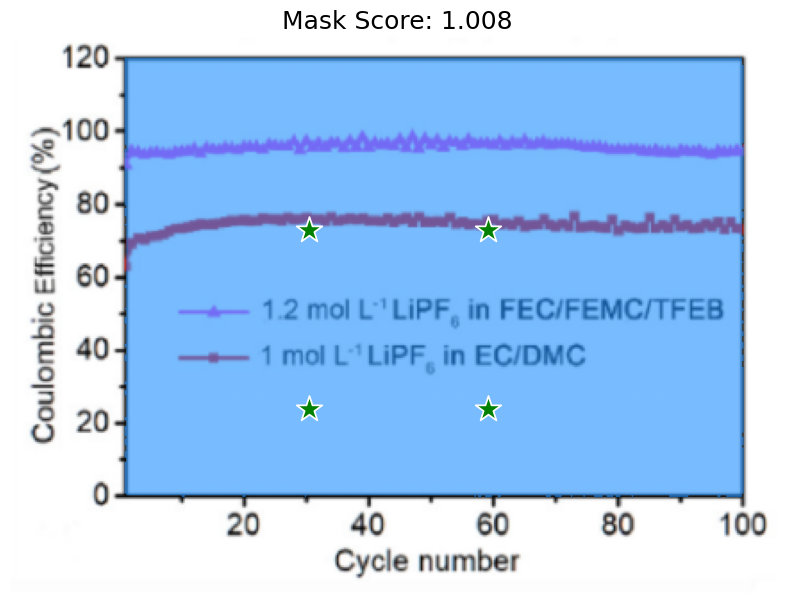

12 64
12 65
12 66
12 67
12 68
12 69
12 70
12 71
12 72
12 73
12 74
12 75
12 76
12 77
12 78
12 79
12 80
12 81
12 82
12 83
12 84
12 85
12 86
12 87
12 88
12 89
12 90
12 91
12 92
12 93
12 94
12 95
12 96
12 97
12 98
12 99
12 100
12 101
12 102
12 103
12 104
12 105
12 106
12 107
12 108
12 109
12 110
12 111
12 112
12 113
12 114
12 115
12 116
12 117
12 118
12 119
12 120
12 121
12 122
12 123
12 124
12 125
12 126
12 127
12 128
12 129
12 130
12 131
12 132
12 133
12 134
12 135
12 136
12 137
12 138
12 139
12 140
12 141
12 142
12 143
12 144
12 145
12 146
12 147
12 148
12 149
12 150
12 151
12 152
12 153
12 154
12 155
12 156
12 157
12 158
12 159
12 160
12 161
12 162
12 163
12 164
12 165
12 166
12 167
12 168
12 169
12 170
12 171
12 172
12 173
12 174
12 175
12 176
12 177
12 178
12 179
12 180
12 181
12 182
12 183
12 184
12 185
12 186
12 187
12 188
12 189
12 190
12 191
12 192
12 193
12 194
12 195
12 196
12 197
12 198
12 199
12 200
12 201
12 202
12 203
12 204
12 205
12 206
12 207
12 208
12 209
12 210
12 211


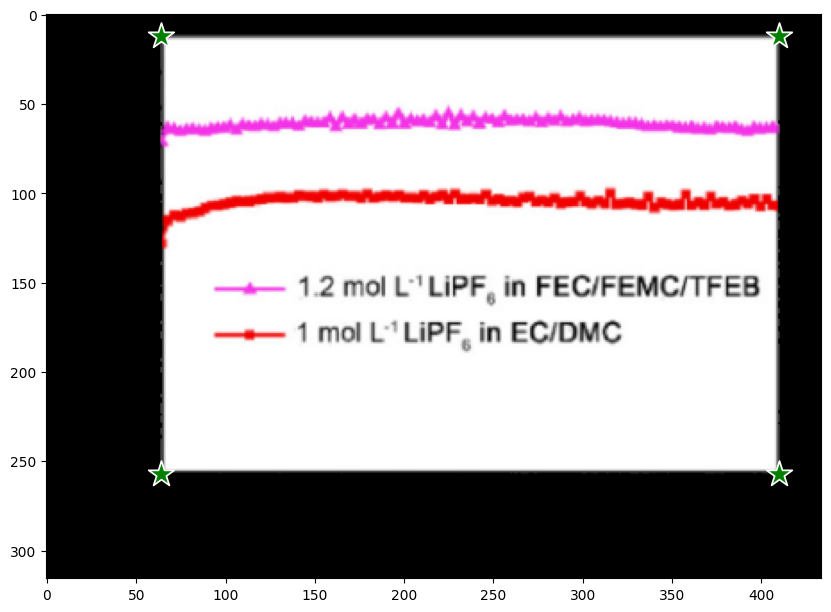






















































































































































































































































































grey
grey





grey
grey
grey
grey
grey





grey
grey
grey
grey











grey
grey





grey
grey
grey
grey
grey

grey



red
grey
grey
grey

grey










grey






grey
grey
grey
grey
grey
grey
grey


grey

grey
grey

grey

grey








grey
grey
grey





grey
grey



grey
grey
grey

grey
grey
grey




grey























grey

red










grey
grey
grey

grey
grey





grey









































































































































































































































































































































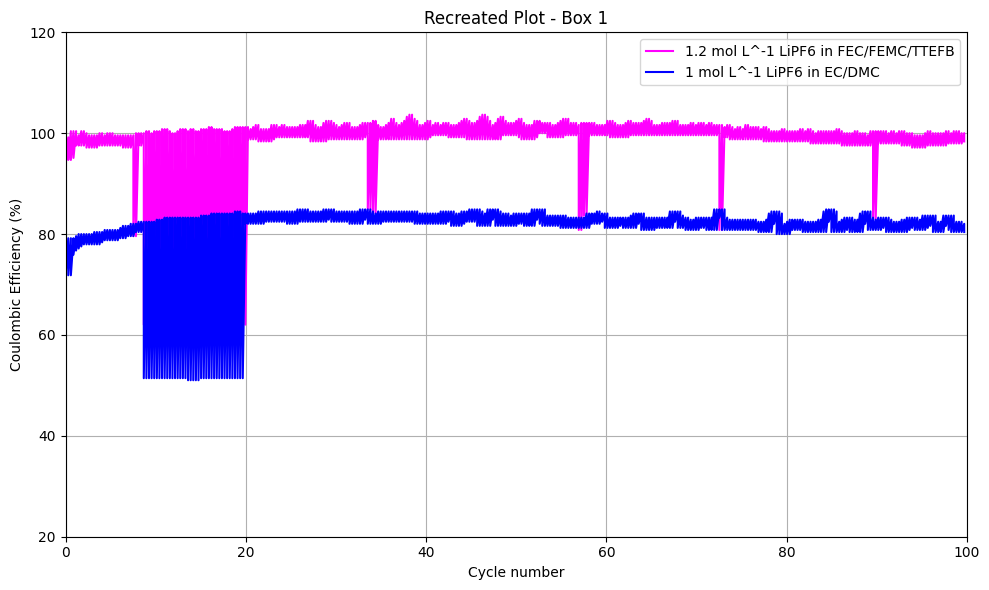

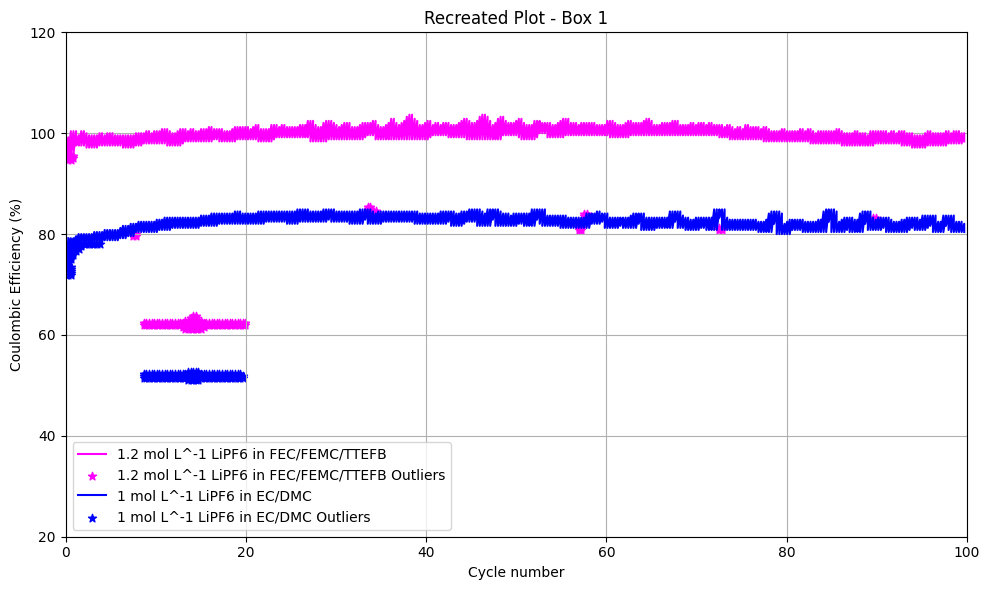

In [40]:
image_num = 5
answers = {
    "x-axis": {
        "title": "Cycle number",
        "range": [0, 100],
    },
    "y-axis": {
        "title": "Coulombic Efficiency (%)",
        "range": [20, 120],
    },
    "types": [
        ("1.2 mol L^-1 LiPF6 in FEC/FEMC/TTEFB", "magenta"),
        ("1 mol L^-1 LiPF6 in EC/DMC", "blue")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)


0.98993194
0.9870082
0.9805394


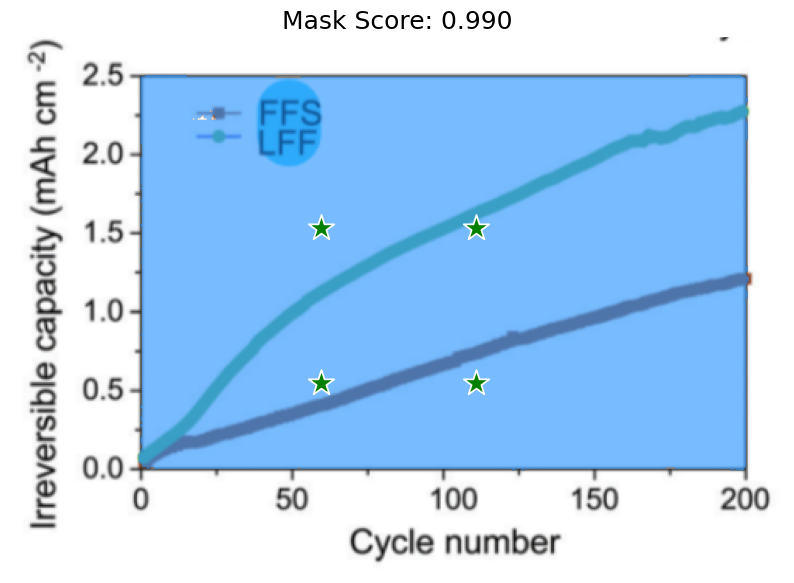

25 87
25 88
25 89
25 90
25 91
25 92
25 93
25 94
25 95
25 96
25 97
25 98
25 99
25 100
25 101
25 102
25 103
25 104
25 105
25 106
25 107
25 108
25 109
25 110
25 111
25 112
25 113
25 438
25 439
25 440
25 441
25 442
25 443
25 444
25 445
25 446
25 447
25 448
25 449
25 450
25 451
25 452
25 453
25 454
25 455
25 456
25 457
25 458
25 459
25 460
25 461
25 462
25 463
25 464
25 465
25 466
25 467
25 468
25 469
25 470
25 471
26 84
26 85
26 86
26 87
26 88
26 89
26 90
26 91
26 92
26 93
26 94
26 95
26 96
26 97
26 98
26 99
26 100
26 101
26 102
26 103
26 104
26 105
26 106
26 107
26 108
26 109
26 110
26 111
26 112
26 113
26 114
26 115
26 116
26 117
26 118
26 119
26 120
26 121
26 122
26 123
26 124
26 125
26 126
26 127
26 128
26 129
26 130
26 131
26 132
26 133
26 134
26 135
26 136
26 137
26 138
26 139
26 140
26 141
26 142
26 143
26 144
26 145
26 146
26 147
26 148
26 149
26 150
26 151
26 152
26 153
26 154
26 155
26 156
26 157
26 158
26 159
26 160
26 161
26 162
26 163
26 164
26 165
26 166
26 167
26 168
26 169


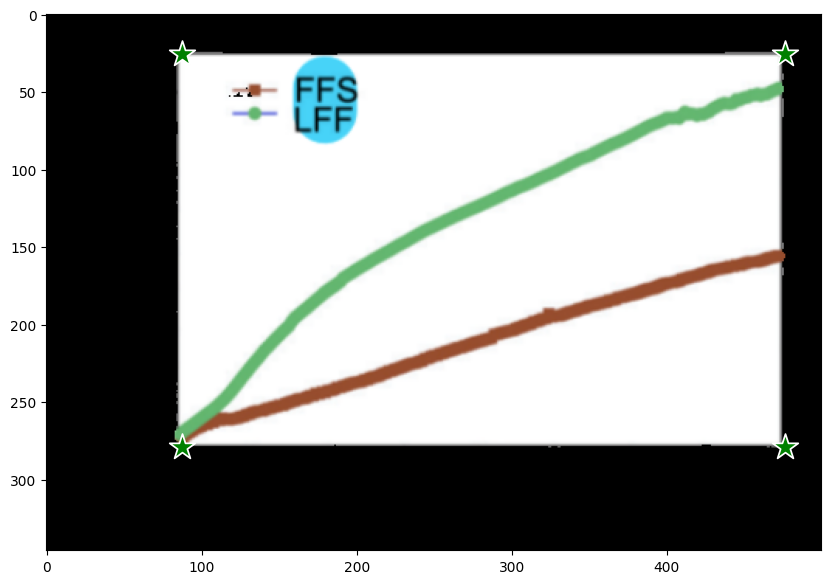































grey
grey
grey
grey
grey







































grey
grey


grey






























grey
grey
grey
grey


















grey
grey
grey
grey
grey
grey
grey
grey
grey
grey



































grey
grey
grey
grey
grey





grey
grey
grey
grey
grey

























grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
red
grey
grey
grey
grey
grey
grey
grey












grey
grey
grey
grey
grey
grey








grey
grey
grey
grey
grey
grey
grey









red
grey
grey














grey
grey
grey
grey









grey



















grey





































grey
grey
grey





grey



















grey
grey
grey
grey
grey
grey


grey
grey
grey







grey
grey
grey
grey
grey
grey
grey

grey
grey
grey






grey
grey



grey
grey
grey
grey
grey
grey
grey







grey
grey
grey



grey
grey
grey
grey
grey
grey












grey
grey
grey



grey
grey
grey
grey
grey


































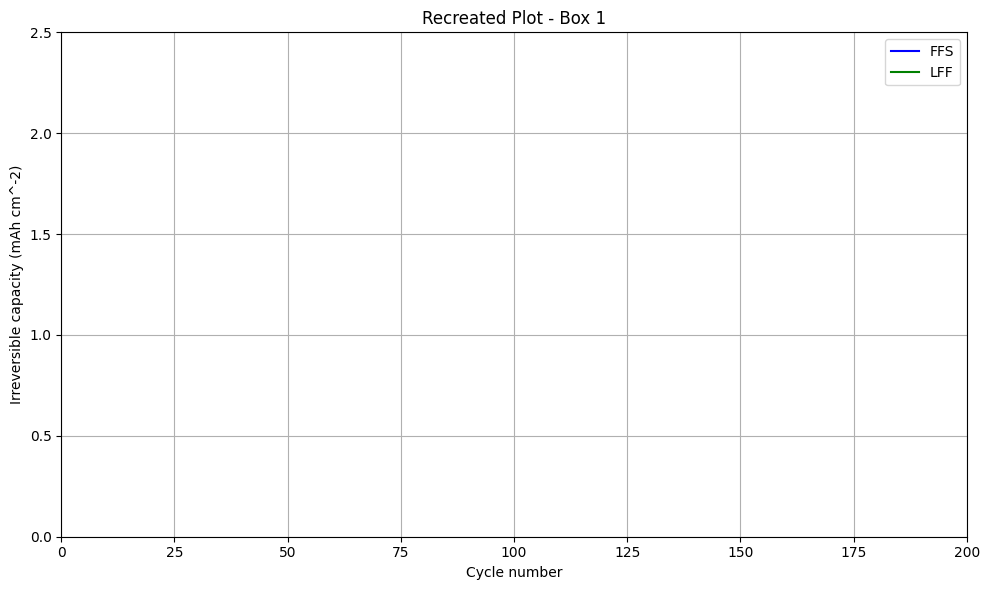

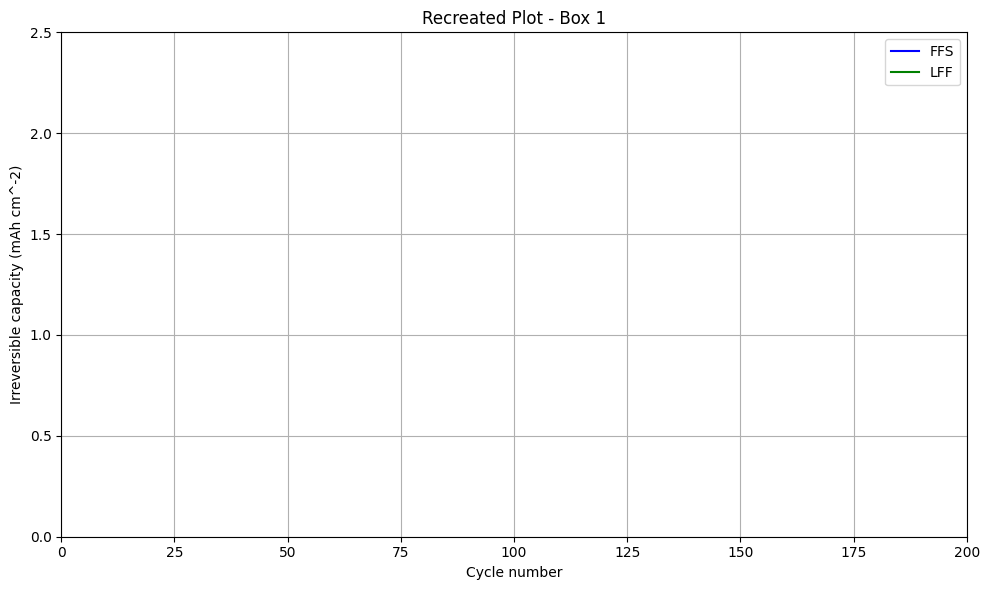

In [41]:
image_num = 8
answers = {
    "x-axis": {
        "title": "Cycle number",
        "range": [0, 200],
    },
    "y-axis": {
        "title": "Irreversible capacity (mAh cm^-2)",
        "range": [0, 2.5],  # Assuming the max value is 2.5 based on the visible plot.
    },
    "types": [
        ("FFS", "blue"),
        ("LFF", "green")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

0.996925
0.9786575
0.85701996


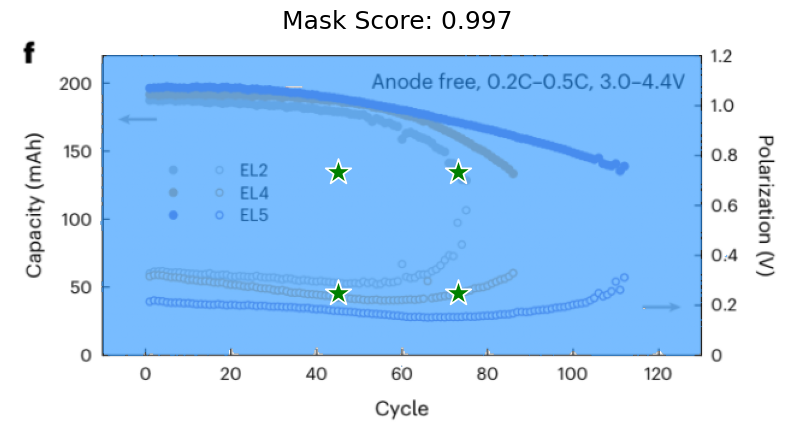

15 80
15 81
15 82
15 83
15 84
15 85
15 86
15 87
15 88
15 89
15 90
15 91
15 92
15 93
15 94
15 95
15 96
15 97
15 98
15 99
15 100
15 101
15 102
15 103
15 104
15 105
15 106
15 107
15 108
15 110
15 111
15 112
15 113
15 114
15 115
15 116
15 117
15 118
15 120
15 121
15 122
15 123
15 124
15 125
15 126
15 127
15 128
15 129
15 130
15 131
15 132
15 133
15 134
15 135
15 136
15 137
15 138
15 139
15 378
15 379
15 387
15 388
15 389
15 398
15 399
15 408
15 409
15 410
15 417
15 418
15 419
15 420
15 421
15 422
15 423
15 427
15 428
15 429
15 430
15 431
15 432
15 433
15 434
15 437
15 438
15 439
15 440
15 441
15 442
15 447
15 448
15 449
15 450
15 451
15 452
15 453
15 454
15 455
15 456
15 457
15 458
15 459
15 460
15 461
15 462
15 463
15 464
15 465
15 466
15 467
15 468
15 469
15 470
15 471
15 472
15 473
15 474
15 475
15 476
15 477
15 478
15 479
15 480
15 481
15 482
15 483
15 484
15 485
15 486
15 487
15 488
15 489
15 490
15 491
15 492
15 493
15 494
15 495
15 496
15 497
15 498
15 499
15 500
15 501
15 502
15 50

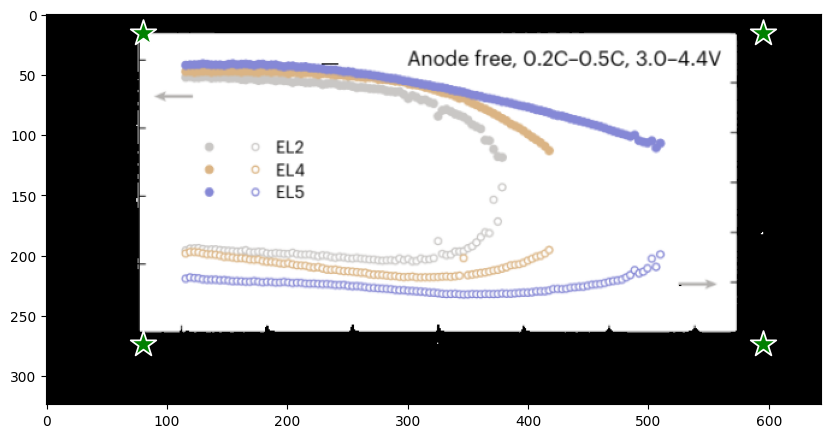



grey
grey
grey
grey


grey
grey




grey

grey


black
black
black

grey

grey

black
black



grey

grey
black
black


grey
grey




black
black

grey




grey
grey

black
black


grey
grey


grey
black
black
black
black
black
black
black

grey


grey



grey
grey
grey


grey
black
black
black
black
black
black
black

grey

grey
grey

grey

grey
grey
grey
grey
grey
grey



grey

black
black


grey
grey



grey
grey
grey
grey

grey
grey


grey





black
black

grey







grey
grey

grey




grey



black
black

grey




grey
grey




grey





black
black

grey


grey







































































































































































































































































































































































































































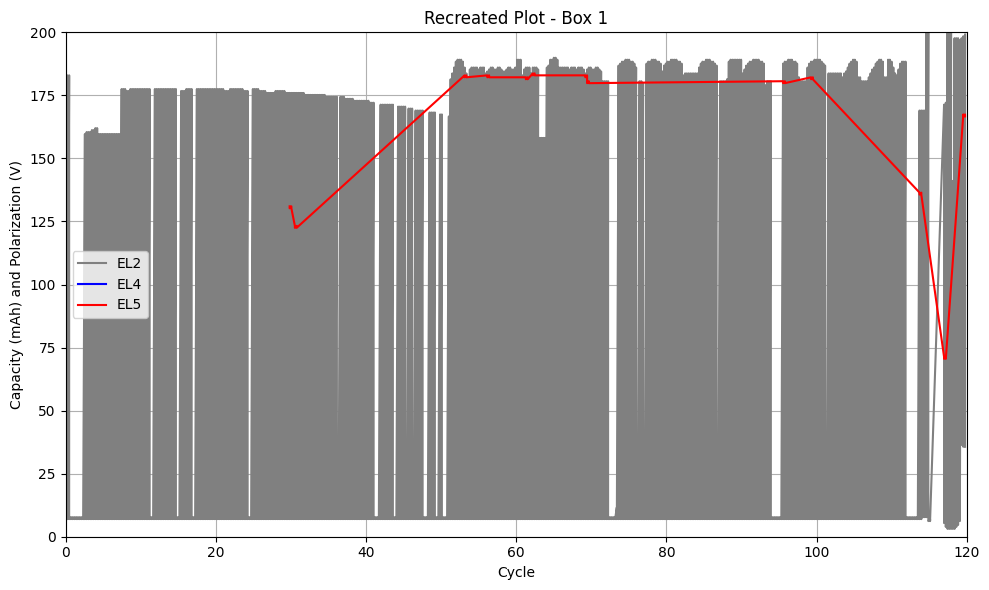

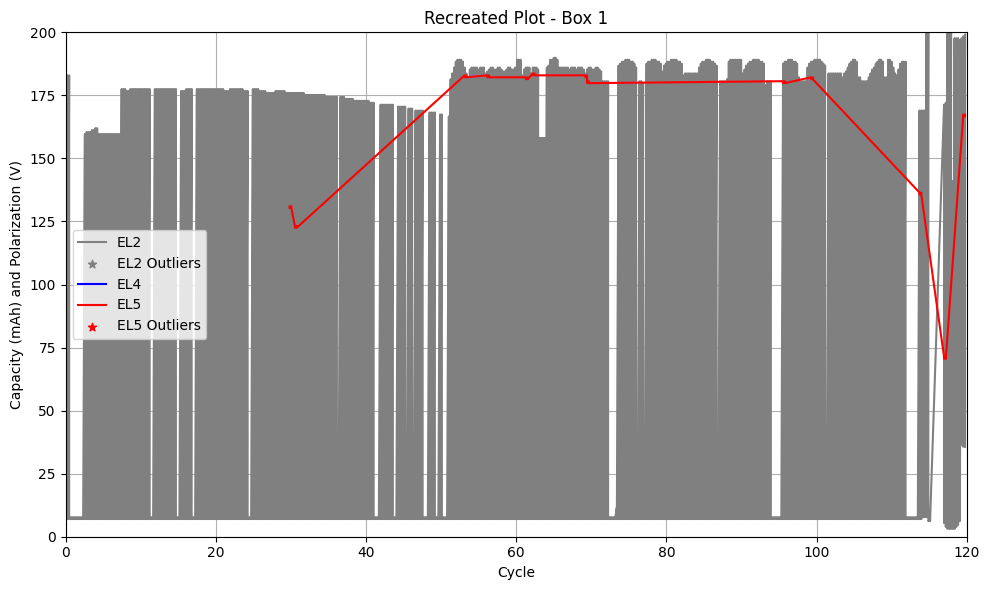

In [42]:
image_num = 13
answers = {
    "x-axis": {
        "title": "Cycle",
        "range": [0, 120],
    },
    "y-axis": {
        "title": "Capacity (mAh) and Polarization (V)",
        "range": [0, 200],  # Note: This range is for Capacity, the Polarization range is from 0 to 1.2 V
    },
    "types": [
        ("EL2", "grey"),
        ("EL4", "blue"),
        ("EL5", "red")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

1.0068711
0.9997237
0.8309482


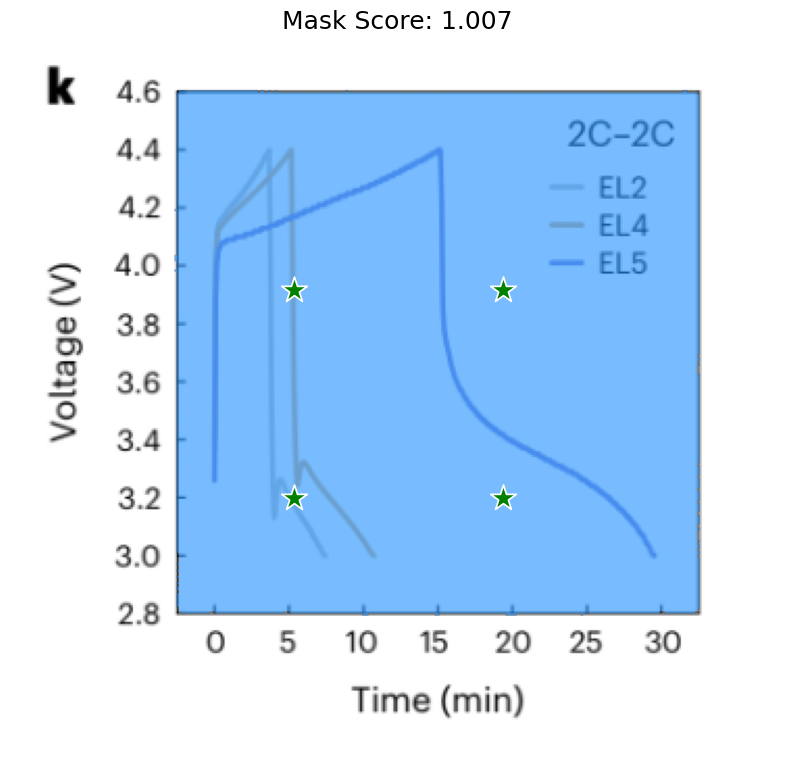

26 81
26 82
26 83
26 84
26 85
26 86
26 87
26 88
26 89
26 90
26 91
26 92
26 93
26 94
26 95
26 96
26 97
26 98
26 99
26 100
26 101
26 102
26 103
26 104
26 105
26 106
26 107
26 108
26 109
26 110
26 111
26 112
26 113
26 114
26 115
26 116
26 117
26 118
26 120
26 121
26 124
26 127
26 161
26 323
26 324
27 80
27 81
27 82
27 83
27 84
27 85
27 86
27 87
27 88
27 89
27 90
27 91
27 92
27 93
27 94
27 95
27 96
27 97
27 98
27 99
27 100
27 101
27 102
27 103
27 104
27 105
27 106
27 107
27 108
27 109
27 110
27 111
27 112
27 113
27 114
27 115
27 116
27 117
27 118
27 119
27 120
27 121
27 122
27 123
27 124
27 125
27 126
27 127
27 128
27 129
27 130
27 131
27 132
27 133
27 134
27 135
27 136
27 137
27 138
27 139
27 140
27 141
27 142
27 143
27 144
27 145
27 146
27 147
27 148
27 149
27 150
27 151
27 152
27 153
27 154
27 155
27 156
27 157
27 158
27 159
27 160
27 161
27 162
27 163
27 164
27 165
27 166
27 167
27 168
27 169
27 170
27 171
27 172
27 173
27 174
27 175
27 176
27 177
27 178
27 179
27 180
27 181
27 182
27 

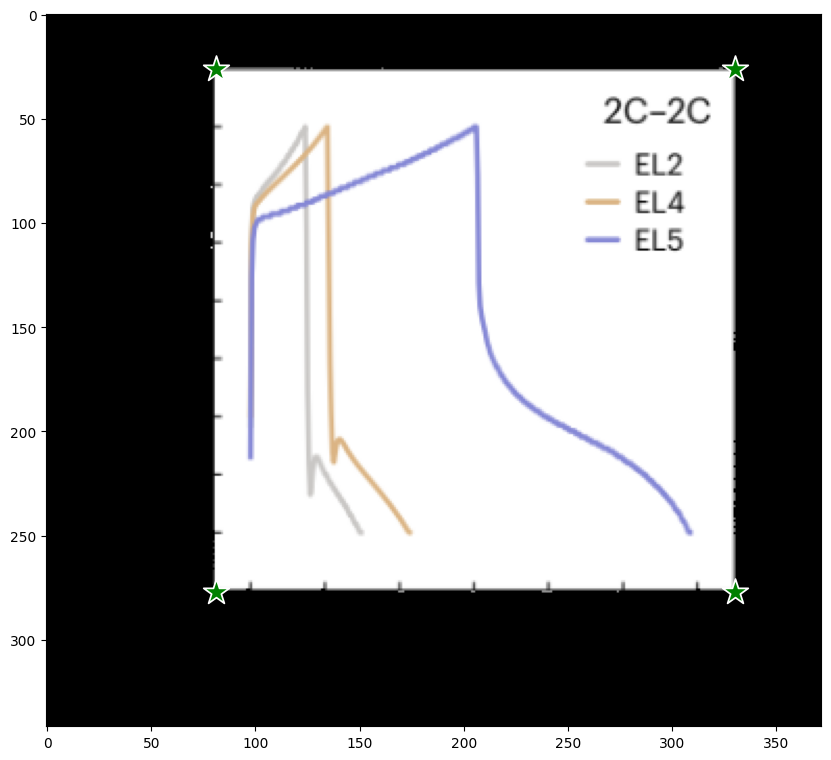



grey
grey
grey
grey



grey




grey


grey

black
black

grey


grey

black
black

grey


grey

black
black

grey


grey

black
black

grey









grey

black
black

grey


grey



grey


grey

black
black

grey

grey

black
black

grey


grey
grey



grey
grey
grey



grey

black
black

grey
grey


black

grey



grey

grey


grey
grey
grey
grey
grey
grey



grey

black
black

grey
grey

black

grey



grey
grey
grey


grey
grey



grey
grey


grey

black
black



black
black

grey


grey
grey
grey
grey


grey
grey
grey




grey

black
black
black
black
black
black

grey


grey
grey

grey
grey


grey
grey
grey
grey

grey
































































































































































































































































grey

black
black
black
black
black
black

grey



grey
grey

grey
grey


grey

grey
grey
grey
grey
grey






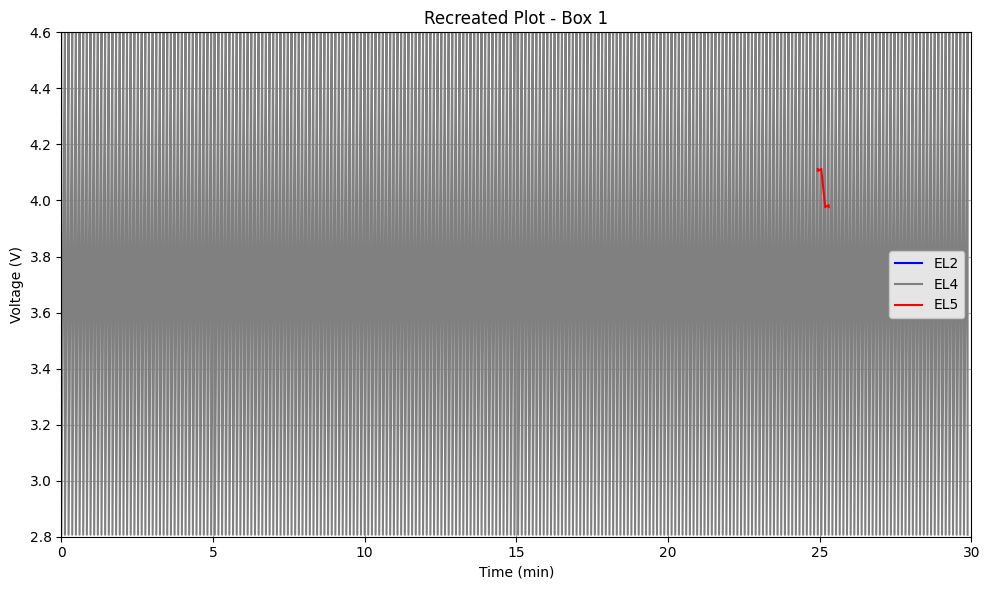

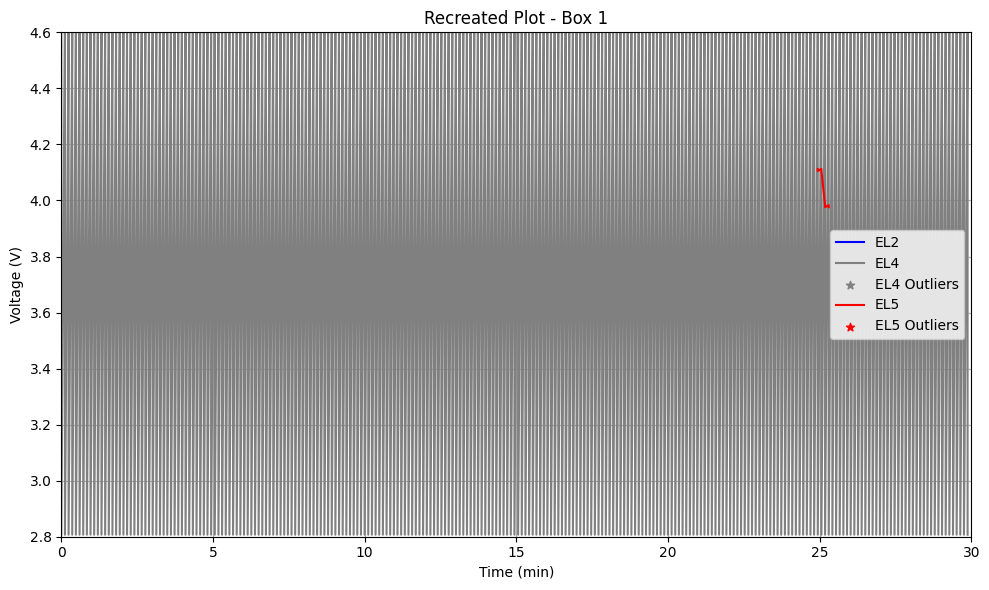

In [43]:
image_num = 17
answers = {
    "x-axis": {
        "title": "Time (min)",
        "range": [0, 30],
    },
    "y-axis": {
        "title": "Voltage (V)",
        "range": [2.8, 4.6],
    },
    "types": [("EL2", "blue"), ("EL4", "grey"), ("EL5", "red")]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

1.0091377
1.0017381
0.7758554


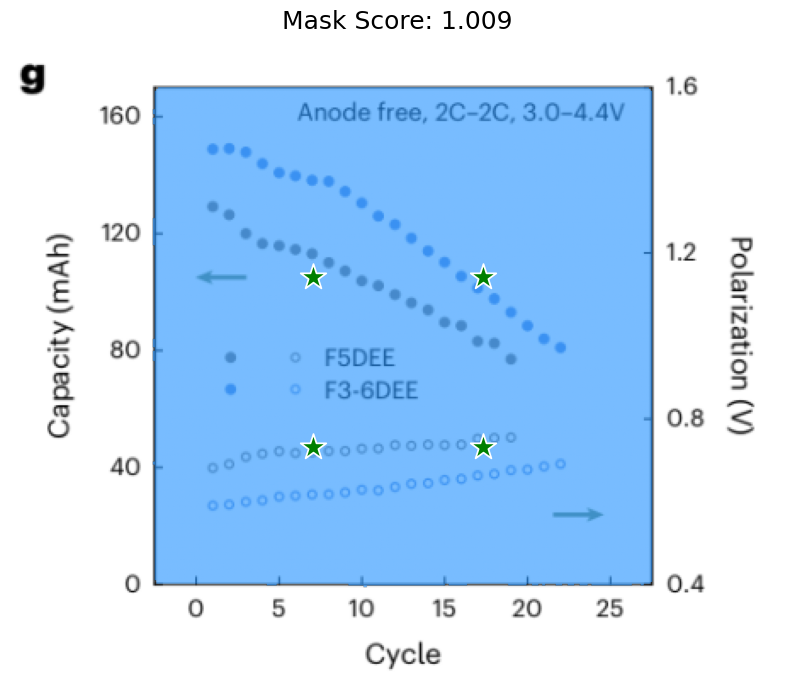

30 87
30 88
30 89
30 90
30 91
30 92
30 93
30 94
30 95
30 96
30 97
30 98
30 99
30 100
30 101
30 102
30 103
30 104
30 105
30 106
30 107
30 108
30 109
30 110
30 111
30 112
30 113
30 114
30 115
30 116
30 117
30 118
30 119
30 120
30 121
30 122
30 123
30 124
30 125
30 126
30 127
30 128
30 129
30 130
30 131
30 132
30 133
30 134
30 135
30 136
30 137
30 138
30 139
30 140
30 141
30 142
30 143
30 144
30 145
30 146
30 147
30 148
30 149
30 150
30 151
30 152
30 153
30 154
30 155
30 156
30 157
30 158
30 159
30 160
30 161
30 162
30 163
30 164
30 165
30 166
30 167
30 168
30 169
30 170
30 171
30 172
30 173
30 174
30 175
30 176
30 177
30 178
30 179
30 180
30 181
30 182
30 183
30 184
30 185
30 186
30 187
30 188
30 189
30 190
30 191
30 192
30 193
30 194
30 195
30 196
30 197
30 198
30 199
30 200
30 201
30 202
30 203
30 204
30 205
30 206
30 207
30 208
30 209
30 210
30 211
30 212
30 213
30 214
30 215
30 216
30 217
30 218
30 219
30 220
30 221
30 222
30 223
30 224
30 225
30 226
30 227
30 228
30 229
30 230
30 23

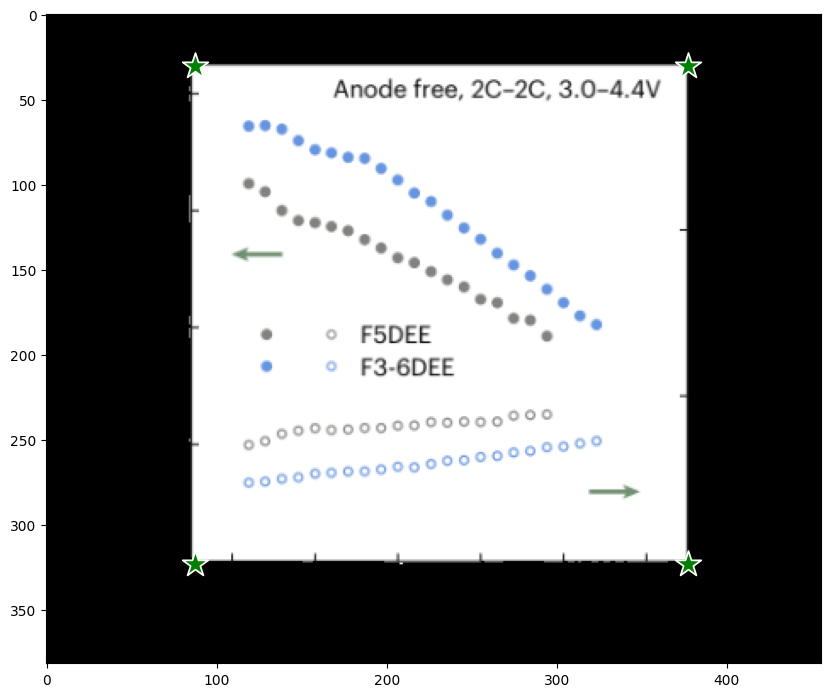




grey
grey









grey
grey




grey
grey







grey


black
black
black




black
black





grey

black
black
black
black
black


black
black
black




grey

black
black


grey
grey
grey

black
black
black




grey

black
black

grey


grey

black
black




grey
black
black
black

grey

grey

black
black




grey

black
black

grey


grey

black
black














grey

black
black

grey


grey


black
black





grey
grey
grey



grey
grey
grey
grey


grey

black
black
black

grey
grey


black
black
black




grey
grey

grey



grey
grey
grey
grey
grey
grey


grey

black
black
black
black
black



black
black




grey
grey
grey
grey


grey
grey


grey
grey



grey


black


grey


black
black






grey
grey



grey
grey

grey







grey
grey
grey
grey
grey

grey

black
black




grey
grey




grey
grey
grey
grey
grey



grey
grey
grey
red
grey
grey



grey

black
black



grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey
grey

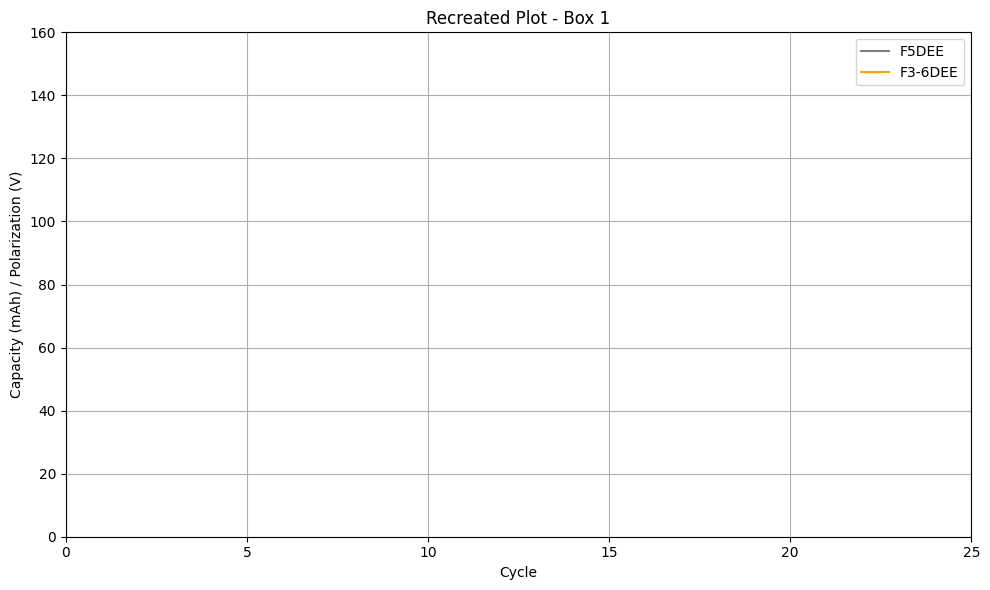

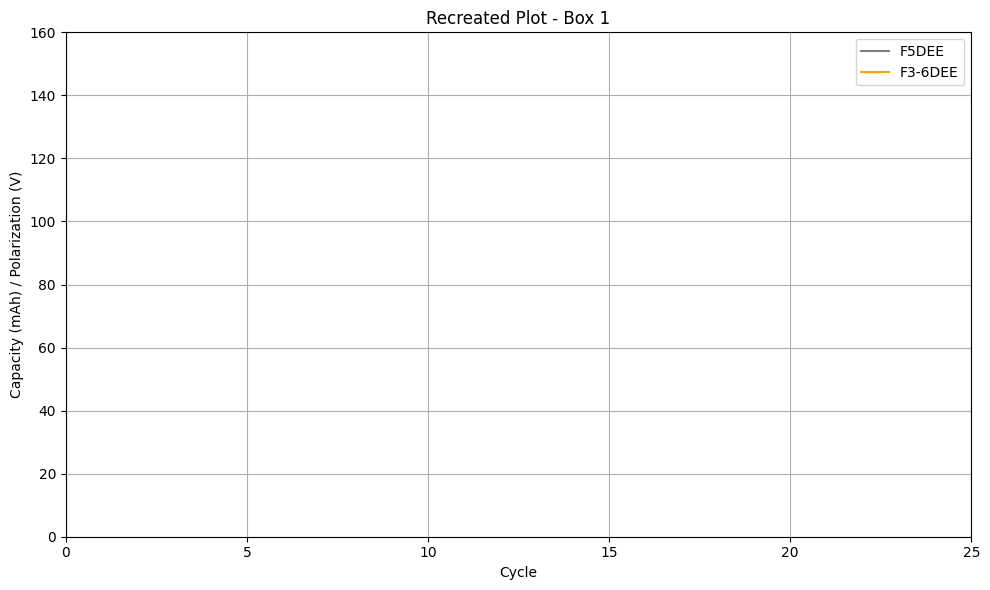

In [44]:
image_num = 21
answers = {
    "x-axis": {
    "title": "Cycle",
    "range": [0, 25], # Assuming this is the cycle number based on the common practice in battery cycle testing
    },
    "y-axis": {
    "title": "Capacity (mAh) / Polarization (V)",
    "range": [0, 160], # Capacity range from 0 to 160 mAh, Polarization range from 0.4 to 1.6 V
    },
    "types": [("F5DEE", "gray"), ("F3-6DEE", "orange")] # The colors are interpreted from the grey scale OCR output
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

0.99946797
0.99579954
0.92327636


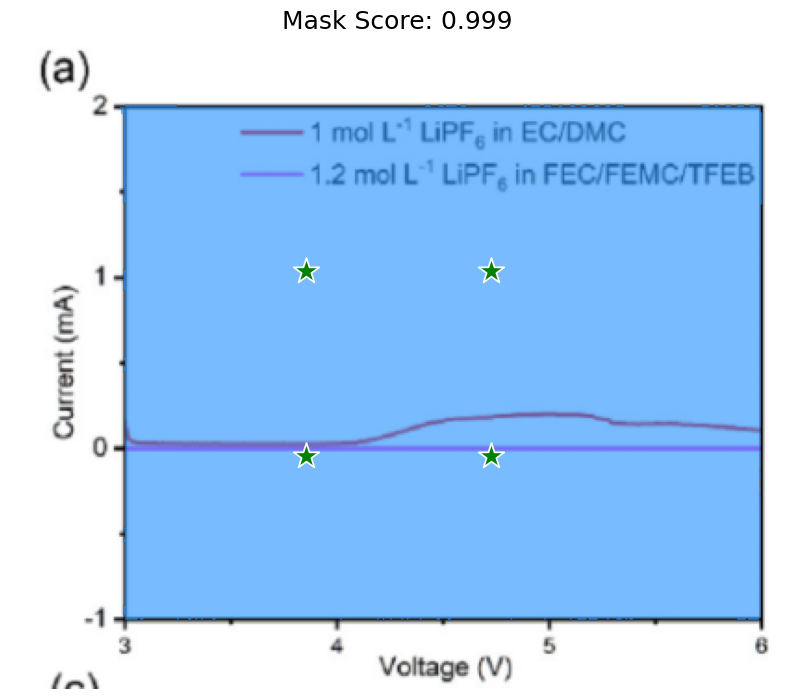

37 62
37 63
37 64
37 65
37 66
37 67
37 68
37 69
37 70
37 71
37 72
37 73
37 74
37 75
37 76
37 77
37 78
37 79
37 80
37 81
37 82
37 83
37 84
37 85
37 86
37 87
37 88
37 89
37 224
37 225
37 226
37 231
37 232
37 233
37 235
37 236
37 237
37 238
37 239
37 240
37 243
37 244
37 245
37 277
37 278
37 281
37 282
37 283
37 284
37 285
37 288
37 289
37 290
37 291
37 296
37 297
37 302
37 303
37 304
37 308
37 309
37 310
37 315
37 316
37 317
37 321
37 322
37 323
37 327
37 328
37 329
37 330
37 373
37 374
37 375
37 376
37 380
37 381
37 386
37 387
37 388
37 392
37 393
37 394
37 395
37 399
37 400
37 401
38 59
38 60
38 61
38 62
38 63
38 64
38 65
38 66
38 67
38 68
38 69
38 70
38 71
38 72
38 73
38 74
38 75
38 76
38 77
38 78
38 79
38 80
38 81
38 82
38 83
38 84
38 85
38 86
38 87
38 88
38 89
38 90
38 91
38 92
38 93
38 94
38 95
38 96
38 97
38 98
38 99
38 100
38 101
38 102
38 103
38 104
38 105
38 106
38 107
38 108
38 109
38 110
38 111
38 112
38 113
38 114
38 115
38 116
38 117
38 118
38 119
38 120
38 121
38 122
38 12

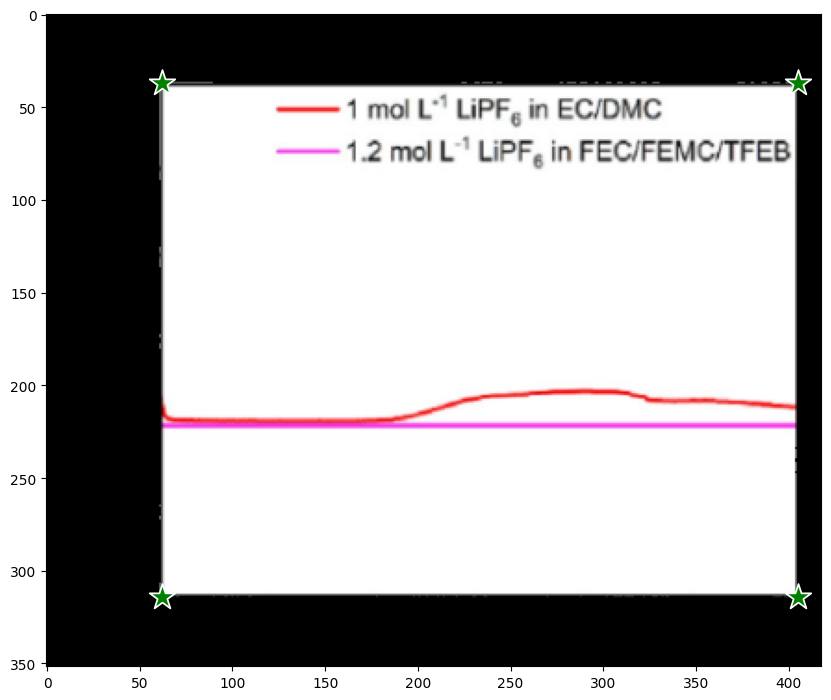


















































grey
grey







grey
grey










grey
grey
grey







grey
grey
grey








grey
grey















grey

grey








grey
grey
grey








grey








grey

grey







grey

grey






grey
grey
grey

grey
grey
grey






grey
grey
grey






grey

grey





grey







grey





grey

grey





grey

grey




grey

grey
grey
grey
grey
grey


grey





grey

grey







grey




grey
grey
grey




grey








grey
grey




















grey







grey

grey














grey
grey
grey
grey







grey

grey











grey
grey
grey



grey







grey

grey











grey

grey
red
grey
grey
grey
grey






grey

grey











grey


grey




grey







grey

grey










grey


grey




grey








grey

grey




grey

grey



grey


grey


grey
grey








grey
grey
grey





grey

grey




grey


grey
grey





grey




grey

grey






grey

grey




grey
grey
grey


grey
grey
grey
grey
grey





grey

grey

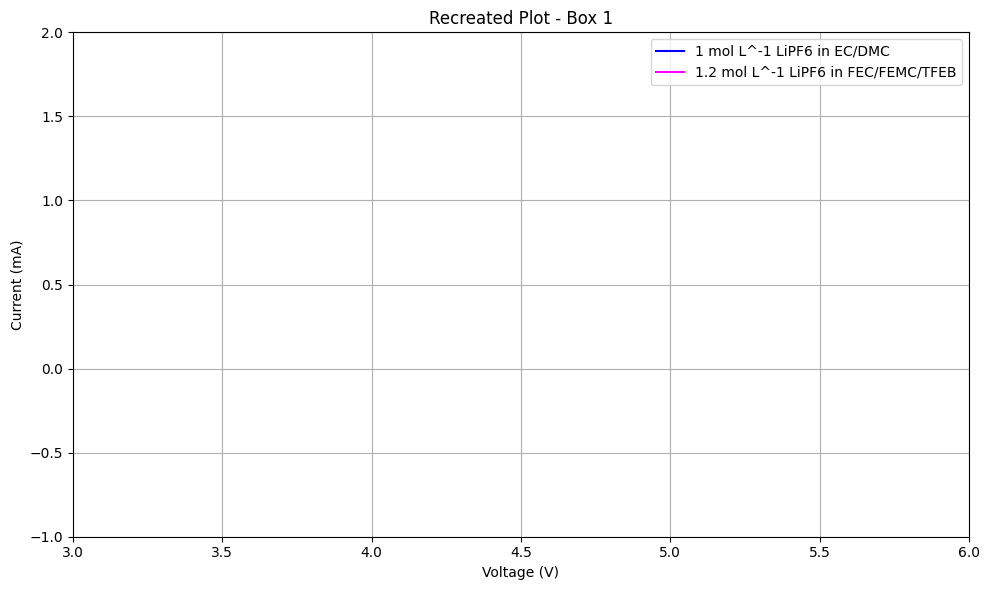

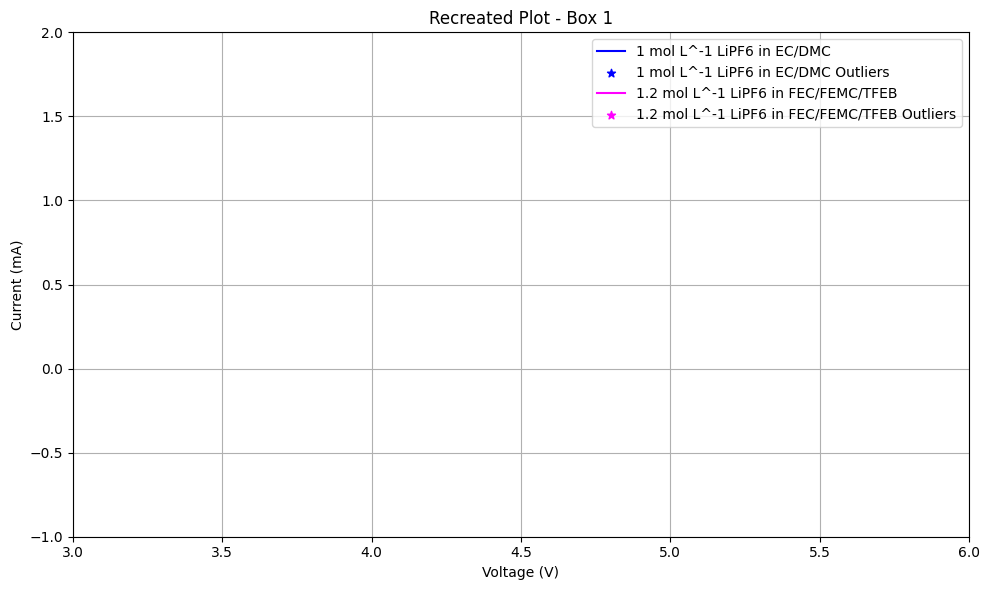

In [45]:
image_num = 1
answers = {
    "x-axis": {
        "title": "Voltage (V)",
        "range": [3, 6],
    },
    "y-axis": {
        "title": "Current (mA)",
        "range": [-1, 2],
    },
    "types": [
        ("1 mol L^-1 LiPF6 in EC/DMC", "blue"),
        ("1.2 mol L^-1 LiPF6 in FEC/FEMC/TFEB", "magenta")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

1.0074476
1.000637
0.71242326


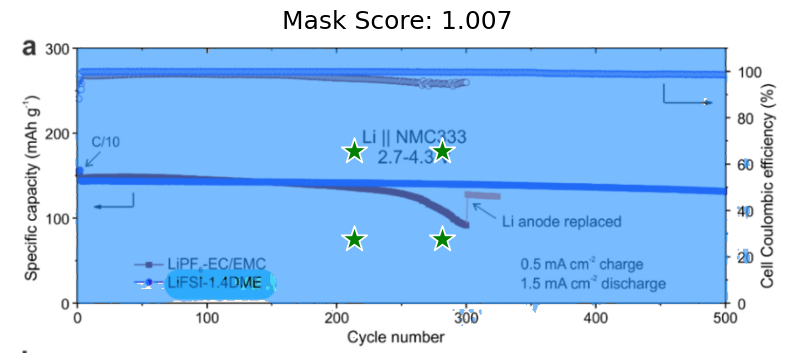

13 81
13 600
13 665
13 666
14 77
14 78
14 79
14 80
14 81
14 82
14 83
14 84
14 85
14 86
14 87
14 88
14 89
14 90
14 91
14 92
14 93
14 94
14 95
14 96
14 97
14 98
14 99
14 100
14 101
14 102
14 103
14 104
14 105
14 106
14 107
14 108
14 109
14 110
14 111
14 112
14 113
14 114
14 115
14 116
14 117
14 118
14 119
14 120
14 121
14 122
14 123
14 124
14 125
14 126
14 127
14 128
14 129
14 130
14 131
14 132
14 133
14 134
14 135
14 136
14 137
14 138
14 139
14 140
14 141
14 142
14 143
14 144
14 145
14 154
14 155
14 156
14 157
14 158
14 159
14 160
14 161
14 162
14 163
14 164
14 165
14 166
14 167
14 168
14 169
14 170
14 171
14 172
14 173
14 174
14 175
14 176
14 177
14 178
14 179
14 180
14 181
14 182
14 183
14 184
14 185
14 186
14 187
14 188
14 189
14 190
14 191
14 192
14 193
14 194
14 195
14 196
14 197
14 198
14 199
14 200
14 201
14 202
14 203
14 204
14 205
14 206
14 207
14 208
14 209
14 210
14 211
14 212
14 213
14 214
14 215
14 216
14 217
14 218
14 219
14 220
14 221
14 235
14 236
14 237
14 238
14 239
14

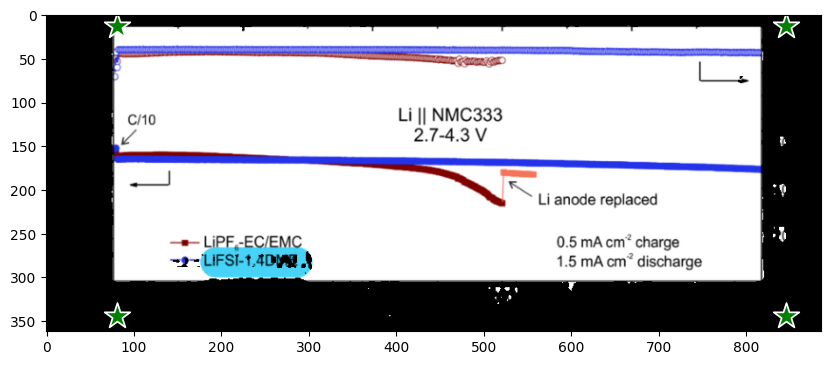
















grey
grey
grey
grey
grey
grey
grey
grey
grey



grey
grey
grey







grey
grey




grey



grey
grey
grey





grey











grey



grey
grey


grey
grey



grey



grey
grey
grey





grey
grey
grey




grey
grey
grey



grey
grey
grey
grey
grey




grey



grey



grey

grey
grey

grey


grey

grey
grey

grey


grey
grey

grey

grey











grey



grey


grey
grey
grey


grey
grey




grey


grey
grey
grey


grey
grey
grey

grey
grey
grey








grey
grey



grey


grey
grey



grey

grey

grey

grey



grey
grey

grey
grey
grey



grey
grey




grey
grey
grey







grey






grey



grey



grey
grey

grey
grey
grey


grey






















































































































































































































































































































































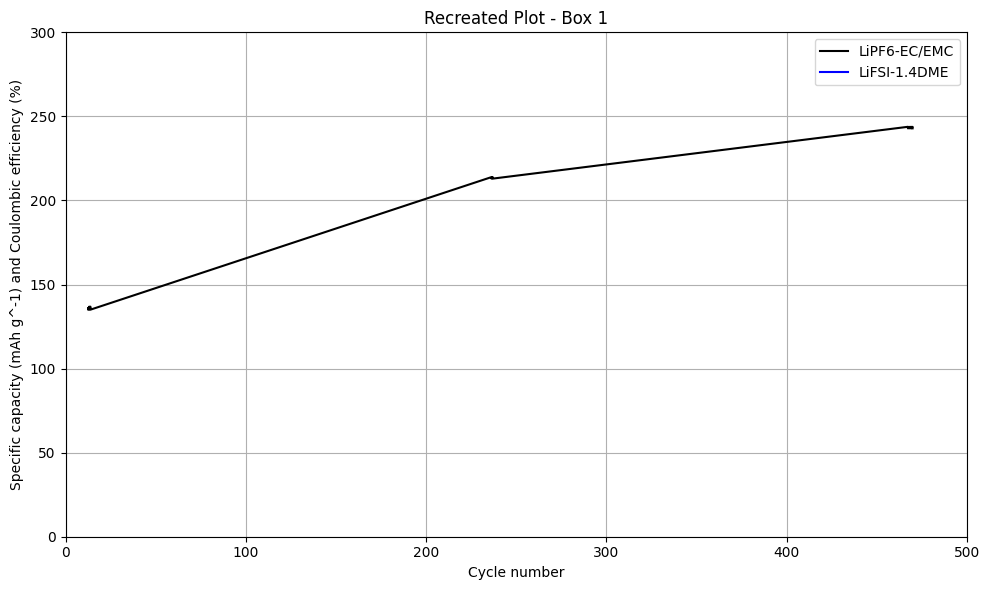

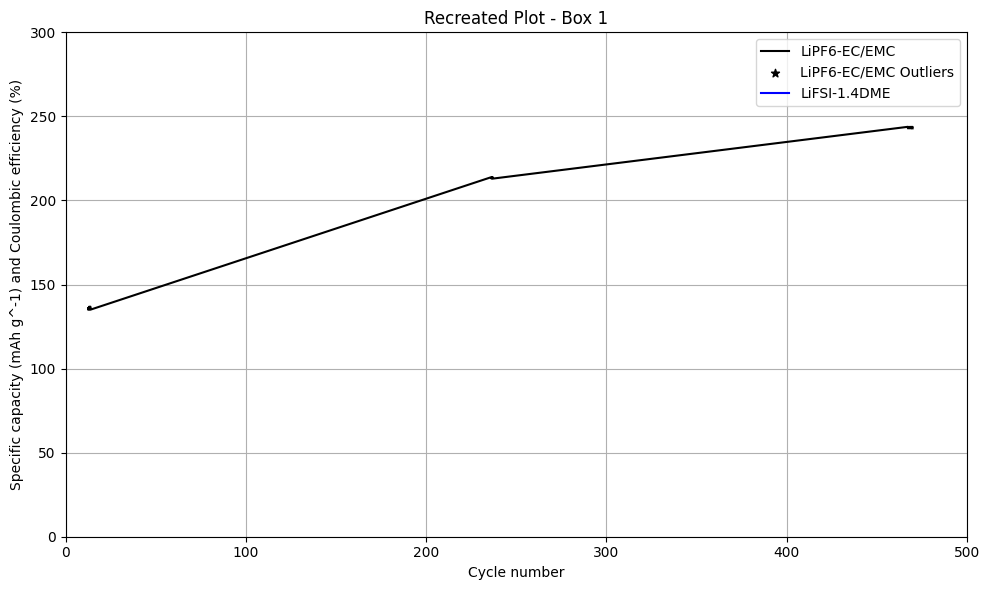

In [46]:
image_num = 28
answers = {
    "x-axis": {
    "title": "Cycle number",
    "range": [0, 500],
    },
    "y-axis": {
    "title": "Specific capacity (mAh g^-1) and Coulombic efficiency (%)",
    "range": [0, 300],
    },
    "types": [
    ("LiPF6-EC/EMC", "black"),
    ("LiFSI-1.4DME", "blue")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

1.0129638
1.0049713
0.7205697


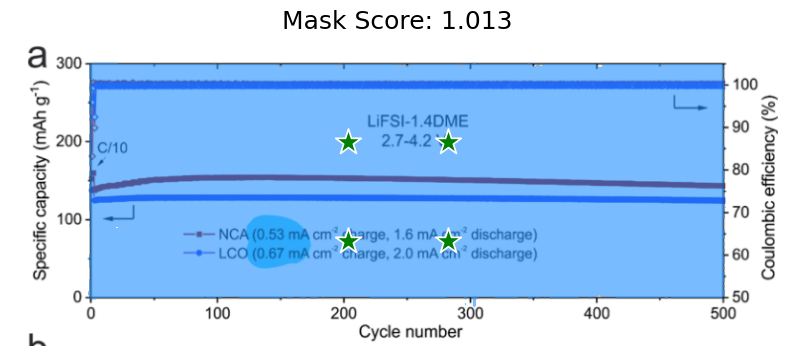

27 82
27 83
27 84
27 85
27 86
27 87
27 88
27 89
27 90
27 91
27 92
27 93
27 94
27 95
27 96
27 97
27 98
27 99
27 100
27 101
27 102
27 103
27 104
27 105
27 106
27 107
27 108
27 138
27 205
27 206
27 467
27 468
27 469
27 522
27 523
27 524
28 81
28 82
28 83
28 84
28 85
28 86
28 87
28 88
28 89
28 90
28 91
28 92
28 93
28 94
28 95
28 96
28 97
28 98
28 99
28 100
28 101
28 102
28 103
28 104
28 105
28 106
28 107
28 108
28 109
28 110
28 111
28 112
28 113
28 114
28 115
28 116
28 117
28 118
28 119
28 120
28 121
28 122
28 123
28 124
28 125
28 126
28 127
28 128
28 129
28 130
28 131
28 132
28 133
28 134
28 135
28 136
28 137
28 138
28 139
28 140
28 141
28 142
28 143
28 144
28 145
28 146
28 147
28 148
28 149
28 150
28 151
28 152
28 153
28 154
28 155
28 156
28 157
28 158
28 159
28 160
28 161
28 162
28 163
28 164
28 165
28 166
28 167
28 168
28 169
28 170
28 171
28 172
28 173
28 174
28 175
28 176
28 177
28 178
28 179
28 180
28 181
28 182
28 183
28 184
28 185
28 186
28 187
28 188
28 189
28 190
28 191
28 192
2

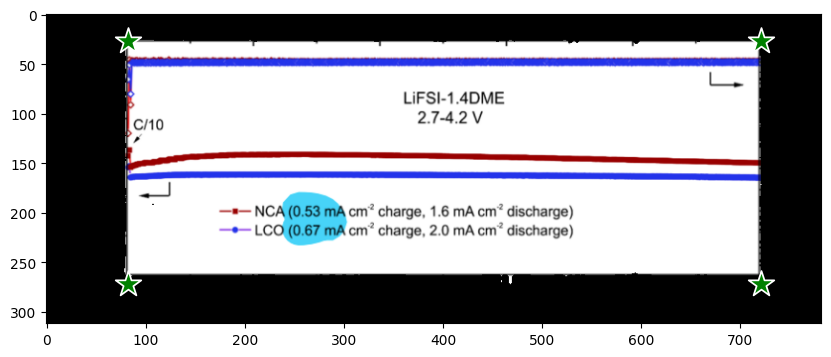





grey
grey
grey
grey
grey
grey






grey
grey
grey






grey
grey
grey




grey











grey
grey



grey



grey
grey
grey
grey
grey
grey
grey



grey
grey


grey



grey







grey



grey


grey


grey




grey


grey



grey


grey


grey


grey











grey


grey










grey
grey


grey








grey
grey
grey
grey
grey




grey







grey
grey
grey
grey










grey

























grey
grey






grey
grey
grey
grey
grey


grey



grey
grey
grey
grey
grey




grey
grey
grey
grey
grey




grey
grey
grey
grey
grey


grey



grey
grey
grey
red
grey
grey



grey


grey



grey

grey
grey
grey

grey


grey
grey
grey
grey
grey
grey
grey


grey

red
grey
grey
grey

grey
grey


grey
grey





grey


grey



grey
grey



grey
grey


grey
grey



grey
grey


grey
grey




grey

grey



grey





grey


grey




grey



grey
grey


grey
grey


grey
grey

grey

grey


grey
grey

grey


grey




grey


grey





grey
grey
grey
grey

grey
grey
grey


grey
grey
grey


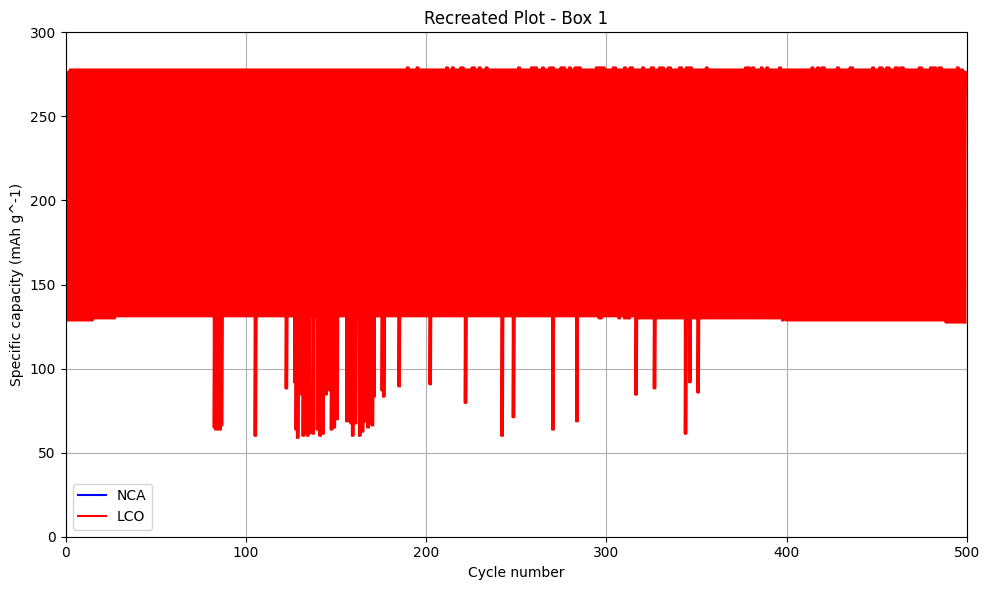

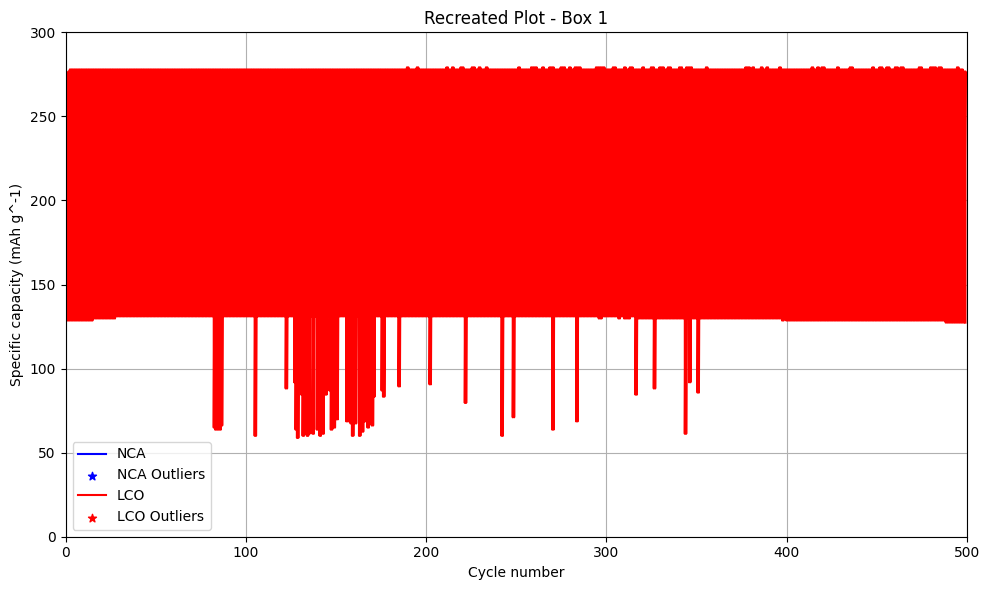

In [47]:
image_num = 33
answers = {
    "x-axis": {
        "title": "Cycle number",
        "range": [0, 500],
    },
    "y-axis": {
        "title": "Specific capacity (mAh g^-1)",
        "range": [0, 300],
    },
    "types": [
        ("NCA", "blue"),
        ("LCO", "red")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

0.99834657
0.99516654
0.97119564


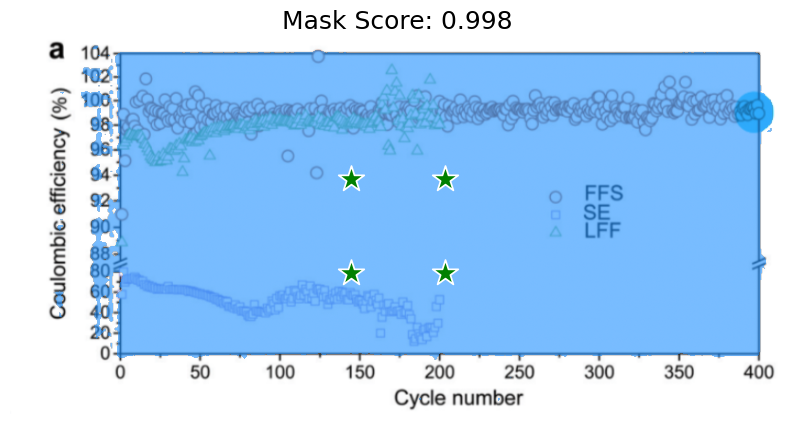

10 89
10 90
10 91
10 92
11 88
11 89
11 90
11 91
11 92
12 87
12 88
12 89
12 90
12 91
12 92
13 87
13 88
13 89
13 90
13 91
15 322
15 323
15 324
15 325
15 326
15 327
16 320
16 321
16 322
16 323
16 324
16 325
16 326
16 327
16 328
16 329
16 330
17 116
17 117
17 118
17 119
17 120
17 121
17 122
17 123
17 124
17 125
17 126
17 127
17 128
17 129
17 130
17 131
17 132
17 133
17 134
17 135
17 136
17 137
17 138
17 139
17 140
17 141
17 142
17 143
17 144
17 145
17 146
17 147
17 148
17 149
17 150
17 151
17 152
17 153
17 154
17 155
17 156
17 157
17 158
17 159
17 160
17 161
17 162
17 163
17 164
17 165
17 166
17 167
17 168
17 169
17 170
17 171
17 172
17 173
17 174
17 175
17 176
17 177
17 178
17 179
17 180
17 181
17 185
17 186
17 187
17 188
17 189
17 199
17 200
17 201
17 202
17 211
17 212
17 213
17 225
17 237
17 238
17 239
17 250
17 251
17 252
17 262
17 263
17 264
17 265
17 266
17 267
17 275
17 276
17 277
17 278
17 289
17 290
17 295
17 300
17 301
17 302
17 303
17 304
17 305
17 306
17 307
17 308
17 309
17 31

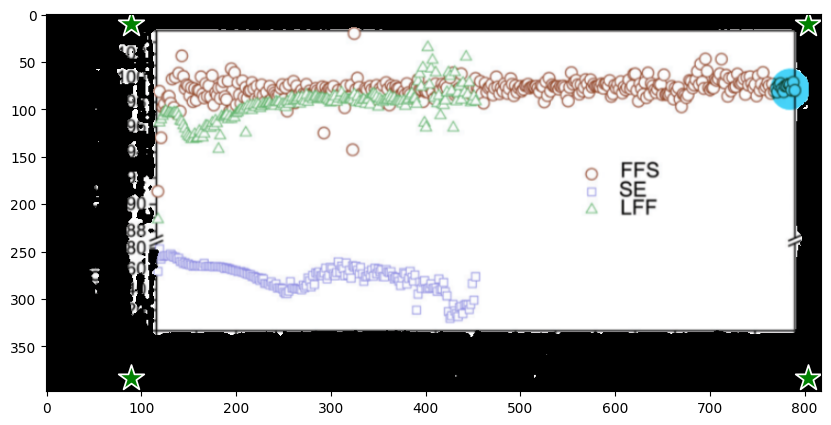












































grey
grey
grey
grey
grey
grey
grey










grey
grey







grey
grey







grey










grey
grey





grey
grey





grey





grey


































grey




grey
grey
grey
grey
grey




grey







grey







grey
grey
grey
grey










grey



























grey
grey
grey
grey
grey




grey




grey







grey
grey
grey




grey
grey
grey
grey
grey
grey
grey








grey
grey
grey






























grey




grey
grey




grey





grey
grey


grey




grey
grey
grey
grey
grey
grey
grey
grey






grey


grey































grey
grey
grey
grey
grey





grey




grey
grey



grey



grey
grey
grey
grey


grey

grey





grey
grey


grey





























grey
grey
grey









grey




grey
grey
grey
grey

grey



grey
grey
grey




grey

grey



grey
grey
grey
grey

grey



























grey
grey






grey





grey




grey
grey
grey
grey

grey



red


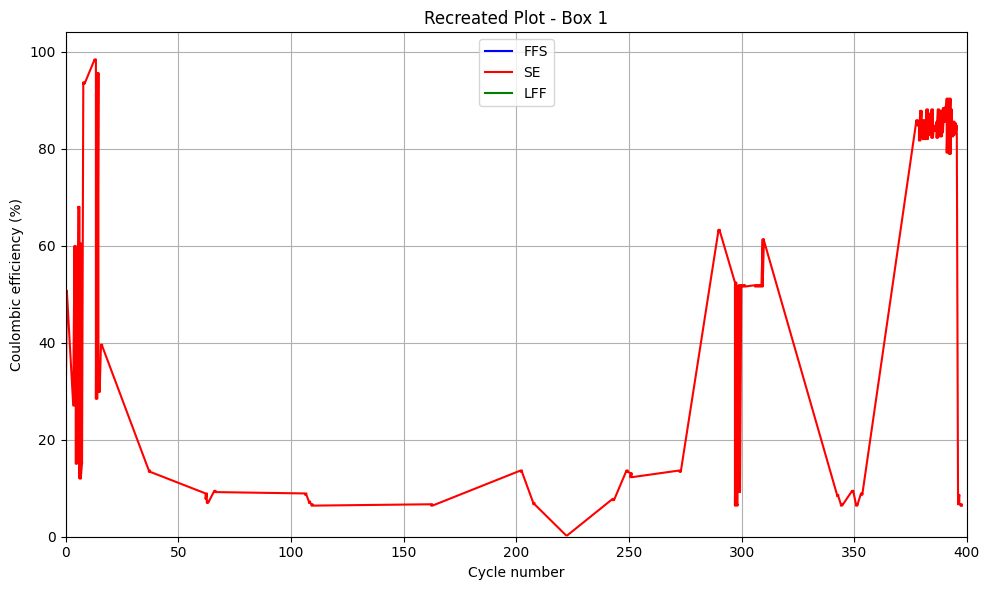

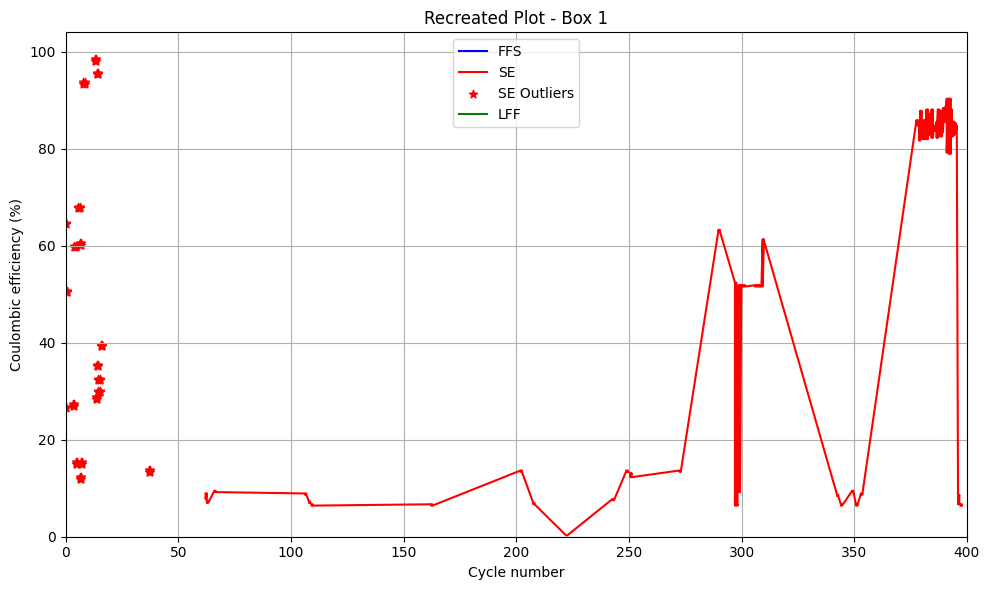

In [48]:
image_num = 7
answers = {
    "x-axis": {
        "title": "Cycle number",
        "range": [0, 400],
    },
    "y-axis": {
        "title": "Coulombic efficiency (%)",
        "range": [0, 104],
    },
    "types": [
        ("FFS", "blue"),
        ("SE", "red"),
        ("LFF", "green")
    ]
}
image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)

1.001338
0.987195
0.922864


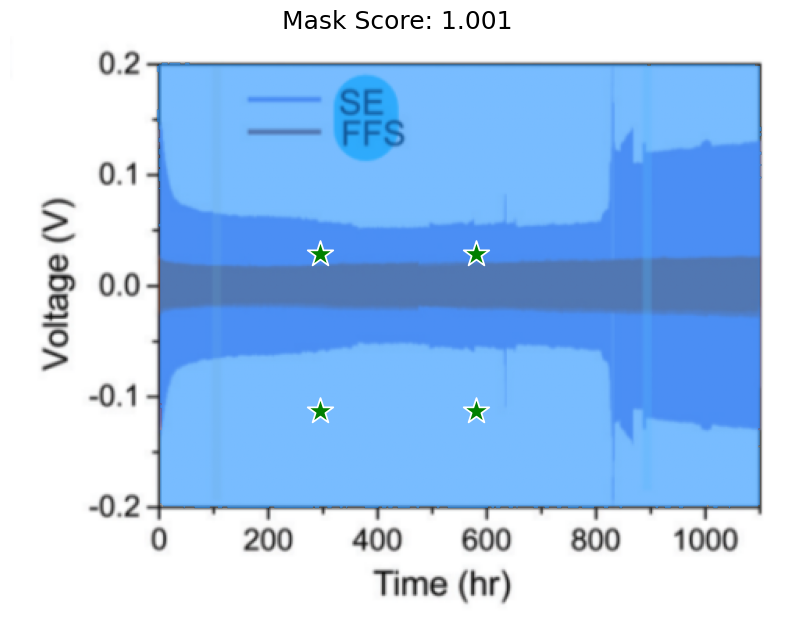

17 97
17 98
17 99
17 100
17 102
17 103
17 104
17 105
17 106
17 107
17 108
17 112
17 113
17 114
18 95
18 96
18 97
18 98
18 99
18 100
18 101
18 102
18 103
18 104
18 105
18 106
18 107
18 108
18 109
18 110
18 111
18 112
18 113
18 114
18 115
18 116
18 117
18 118
18 119
18 120
18 121
18 122
18 123
18 124
18 125
18 126
18 127
18 128
18 129
18 130
18 131
18 132
18 133
18 134
18 135
18 136
18 137
18 138
18 139
18 140
18 141
18 142
18 143
18 144
18 145
18 146
18 147
18 148
18 149
18 150
18 151
18 152
18 153
18 154
18 155
18 156
18 157
18 158
18 159
18 160
18 161
18 162
18 163
18 164
18 165
18 166
18 167
18 168
18 169
18 170
18 171
18 172
18 173
18 174
18 175
18 176
18 177
18 178
18 179
18 180
18 181
18 182
18 183
18 184
18 185
18 186
18 187
18 188
18 189
18 190
18 191
18 192
18 193
18 194
18 195
18 196
18 197
18 198
18 199
18 200
18 201
18 202
18 203
18 204
18 205
18 206
18 207
18 208
18 209
18 210
18 211
18 212
18 213
18 214
18 215
18 216
18 217
18 218
18 219
18 220
18 221
18 222
18 223
18 224


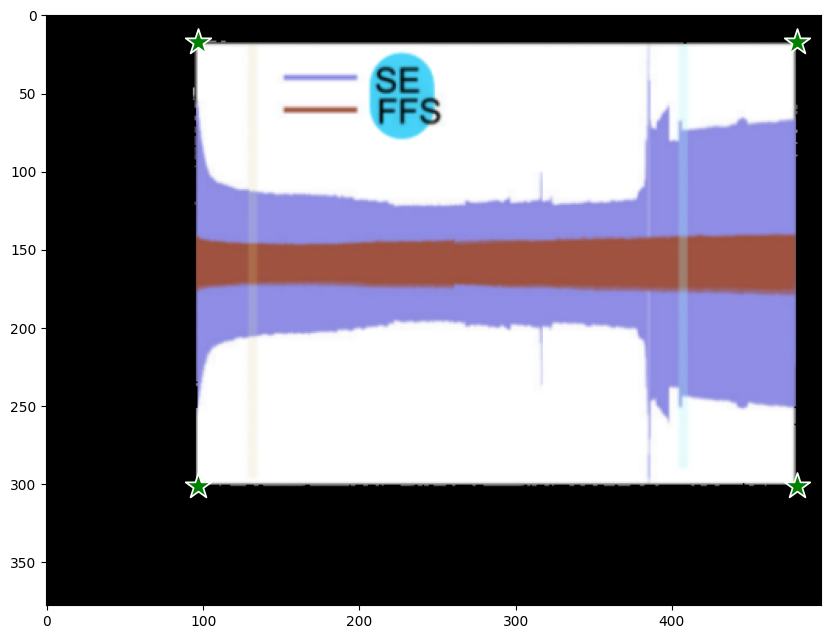




















































































































grey
grey
grey
grey
grey










grey
grey
grey
grey
grey
grey














grey
grey
grey
grey
grey
grey
grey
grey








grey
grey
grey
grey
grey
grey
grey
grey













grey
grey
grey
grey
grey
grey
grey
grey








grey
grey
grey
grey
grey
grey
grey
grey
grey











grey
grey
grey
grey



grey
grey
grey






grey
grey
grey




grey

grey











grey
grey
grey




grey

grey







grey
grey




grey
grey
grey











grey
grey
grey




grey
grey
grey












grey
grey
grey
grey























































































































































































































































































































































































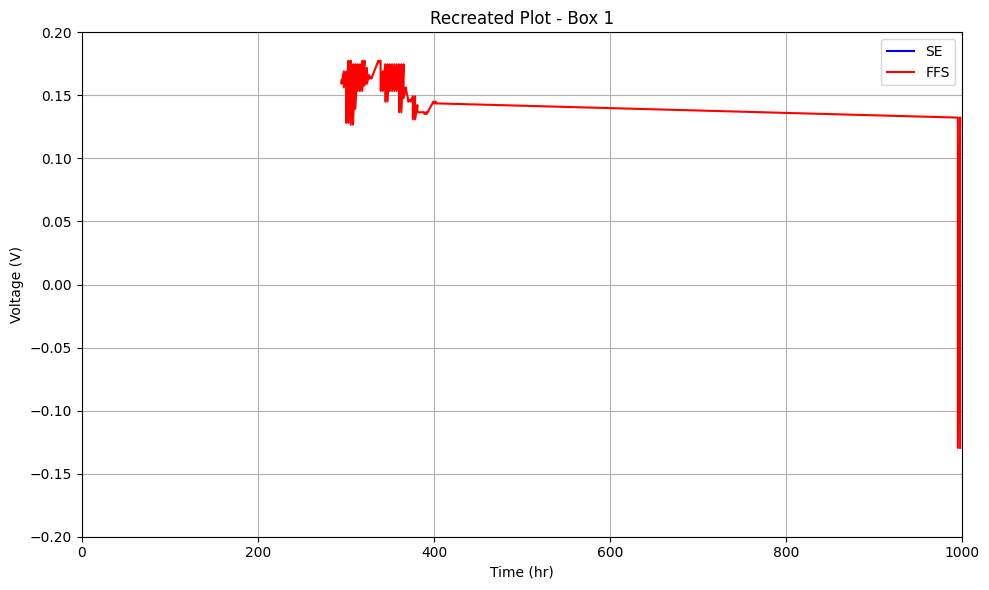

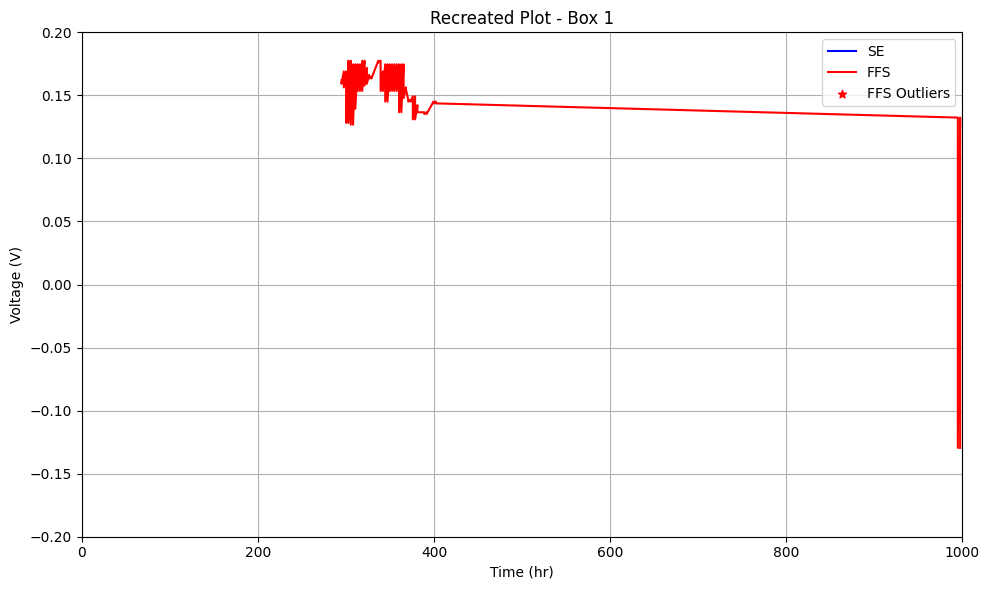

In [49]:
image_num = 10
answers = {
    "x-axis": {
        "title": "Time (hr)",
        "range": [0, 1000]
    },
    "y-axis": {
        "title": "Voltage (V)",
        "range": [-0.2, 0.2]
    },
    "types": [("SE", "blue"), ("FFS", "red")],
}

image_name, boundingBox = do_analysis(image_num)
answers = do_complete_analysis(image_num, 1, 1, answers, 150, image_name, boundingBox)